<a href="https://colab.research.google.com/github/codebuzer/Bioactivity-Prediction-App/blob/main/danish.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import pandas as pd
import numpy as np
import logging
import tensorflow as tf
import warnings
import glob
import tqdm
import os


In [2]:
from tqdm import tqdm 
from IPython import display 
import matplotlib.pyplot as plt
import seaborn as sns
from seaborn import heatmap


In [3]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report

from skimage.io import imread, imshow
from skimage.transform import resize

In [6]:
from keras.models import Sequential, load_model
from keras.layers import Conv2D, Lambda, MaxPooling2D, Dense, Dropout, Flatten # convolution layers & core layers

from tensorflow.keras.layers import BatchNormalization
from keras.preprocessing.image import ImageDataGenerator
from keras.utils.np_utils import to_categorical

In [7]:
from tensorflow import keras
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.preprocessing import image_dataset_from_directory
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, History

In [8]:
# Directory paths for importing data

base_dir = "/content/drive/MyDrive/New folder (2)"
train_dir = os.path.join(base_dir, "train")
test_dir = os.path.join(base_dir, "test")

In [12]:
# Os path join (train)

train_C0_0 = glob.glob(os.path.join(train_dir, 'C0_0', '*.png'))
train_C1_0 =  glob.glob(os.path.join(train_dir, 'C1_0', '*.png'))
train_C1_1 =  glob.glob(os.path.join(train_dir, 'C1_1', '*.png'))
train_C2_0 =  glob.glob(os.path.join(train_dir, 'C2_0', '*.png'))
train_C3_0 =  glob.glob(os.path.join(train_dir, 'C3_0', '*.png'))
train_C4_0 =  glob.glob(os.path.join(train_dir, 'C4_0', '*.png'))
train_C5_0 =  glob.glob(os.path.join(train_dir, 'C5_0', '*.png'))
train_C6_0 =  glob.glob(os.path.join(train_dir, 'C6_0', '*.png'))
train_C6_1 =  glob.glob(os.path.join(train_dir, 'C6_1', '*.png'))

a = len(train_C0_0)
b = len(train_C1_0)
c = len(train_C1_1)
d = len(train_C2_0)
e = len(train_C3_0)
f = len(train_C4_0)
g = len(train_C5_0)
h = len(train_C6_0)
i = len(train_C6_1)



print("Number of training samples: {}".format(a+b+c+d+e+f+g+h+i))

Number of training samples: 190


In [13]:
# Os path join (test)
test_C0_0 = glob.glob(os.path.join(test_dir, 'C0_0', '*.png'))
test_C1_0 =  glob.glob(os.path.join(test_dir, 'C1_0', '*.png'))
test_C1_1 =  glob.glob(os.path.join(test_dir, 'C1_1', '*.png'))
test_C2_0 =  glob.glob(os.path.join(test_dir, 'C2_0', '*.png'))
test_C3_0 =  glob.glob(os.path.join(test_dir, 'C3_0', '*.png'))
test_C4_0 =  glob.glob(os.path.join(test_dir, 'C4_0', '*.png'))
test_C5_0 =  glob.glob(os.path.join(test_dir, 'C5_0', '*.png'))
test_C6_0 =  glob.glob(os.path.join(test_dir, 'C6_0', '*.png'))
test_C6_1 =  glob.glob(os.path.join(test_dir, 'C6_1', '*.png'))

a = len(test_C0_0)
b = len(test_C1_0)
c = len(test_C1_1)
d = len(test_C2_0)
e = len(test_C3_0)
f = len(test_C4_0)
g = len(test_C5_0)
h = len(test_C6_0)
i = len(test_C6_1)



print("Number of testing samples: {}".format(a+b+c+d+e+f+g+h+i))

Number of testing samples: 41


In [14]:
# Datagenerators

train_datagen = ImageDataGenerator(rescale = 1.0 / 255.0,
                                   zoom_range = 0.4,
                                   rotation_range = 10,
                                   horizontal_flip = True,
                                   vertical_flip = True,
                                   validation_split = 0.2)

valid_datagen = ImageDataGenerator(rescale = 1.0 / 255.0,
                                   validation_split = 0.2)

test_datagen  = ImageDataGenerator(rescale = 1.0 / 255.0)


In [15]:
# Train dataset

train_ds  = train_datagen.flow_from_directory(directory = train_dir,
                                                   target_size = (180, 180),
                                                   class_mode = 'categorical',
                                                   batch_size = 32, 
                                                   subset = 'training')

Found 157 images belonging to 9 classes.


In [16]:
# Validate dataset

valid_ds = valid_datagen.flow_from_directory(directory = train_dir,
                                                  target_size = (180, 180),
                                                  class_mode = 'categorical',
                                                  batch_size = 32, 
                                                  subset = 'validation')

Found 33 images belonging to 9 classes.


In [17]:
# Test dataset

test_ds = test_datagen.flow_from_directory(directory = test_dir,
                                                  target_size = (180, 180),
                                                  class_mode = 'categorical',
                                                  batch_size = 32,
                                                  shuffle=False)

Found 41 images belonging to 9 classes.


In [18]:
# Check classes

print(train_ds.class_indices)
print(test_ds.class_indices)

{'C0_0': 0, 'C1_0': 1, 'C1_1': 2, 'C2_0': 3, 'C3_0': 4, 'C4_0': 5, 'C5_0': 6, 'C6_0': 7, 'C6_1': 8}
{'C0_0': 0, 'C1_0': 1, 'C1_1': 2, 'C2_0': 3, 'C3_0': 4, 'C4_0': 5, 'C5_0': 6, 'C6_0': 7, 'C6_1': 8}


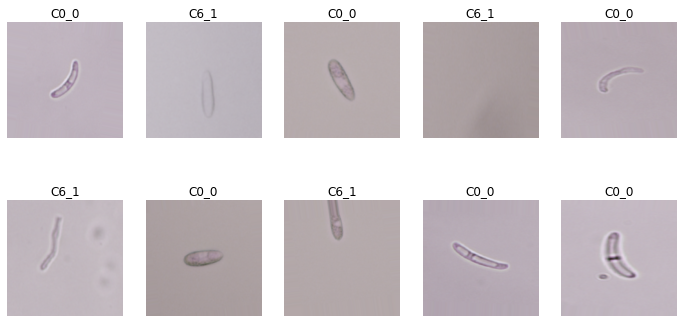

In [24]:
# Viewing images

fig, ax = plt.subplots(nrows = 2, ncols = 5, figsize = (12,6))
#plt.subplots_adjust(hspace=0.55)

for i in range(2):
    for j in range(5):
        rand1 = np.random.randint(len(train_ds))
        rand2 = np.random.randint(32)
        ax[i,j].imshow(train_ds[rand1][0][rand2])
        ax[i,j].axis('off')
        label = train_ds[rand1][1][rand2]
        # print(label[0])
        if label[0] == 0:
            ax[i,j].set_title('C0_0')
        elif label[1] == 1:
            ax[i,j].set_title('C1_0')
        elif label[2] == 2:
            ax[i,j].set_title('C1_1')
        elif label[3] == 3:
            ax[i,j].set_title('C2_0')
        elif label[4] == 4:
            ax[i,j].set_title('C3_0')
        elif label[5] == 5:
            ax[i,j].set_title('C4_0')
        elif label[6] == 6:
            ax[i,j].set_title('C5_0')
        elif label[7] == 7:
            ax[i,j].set_title('C6_0')
        else:
          ax[i,j].set_title('C6_1')


plt.tight_layout
plt.show()

In [25]:
#Building The Model
# Defining callbacks

filepath = './final_model_weights.hdf5'

earlystopping = EarlyStopping(monitor = 'val_auc', 
                              mode = 'max' , 
                              patience = 5,
                              verbose = 1)

checkpoint = ModelCheckpoint(filepath, 
                                monitor = 'val_auc', 
                                mode='max', 
                                save_best_only=True, 
                                verbose = 1)


callback_list = [earlystopping, checkpoint]

In [26]:
# Base model

base_model = VGG16(input_shape=(180,180,3), 
                   include_top=False,
                   weights="imagenet")

In [22]:
# Freezing layers 

for layer in base_model.layers:
    layer.trainable=False

In [27]:
# Base model

base_model = VGG16(input_shape=(180,180,3), 
                   include_top=False,
                   weights="imagenet")

In [28]:
# Show vgg model summary
base_model.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, 180, 180, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 180, 180, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 180, 180, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 90, 90, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 90, 90, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 90, 90, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 45, 45, 128)       0     

block1_conv1
64


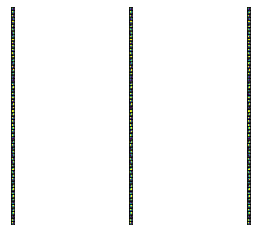

block1_conv2
64


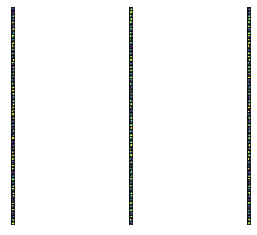

block2_conv1
128


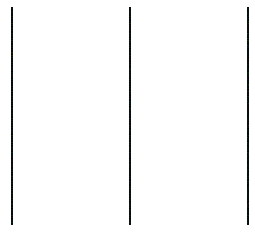

block2_conv2
128


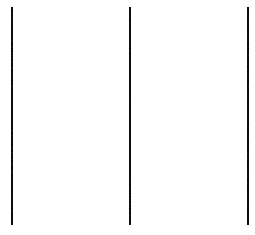

block3_conv1
256


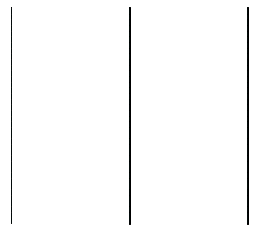

block3_conv2
256


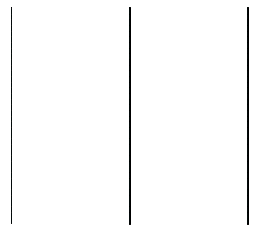

block3_conv3
256


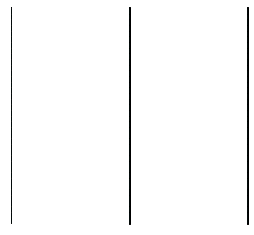

block4_conv1
512


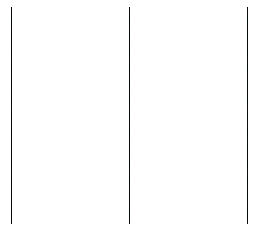

block4_conv2
512


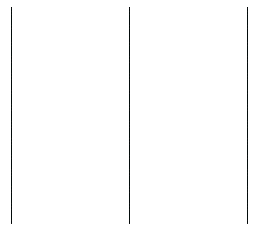

block4_conv3
512


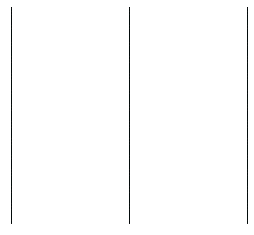

block5_conv1
512


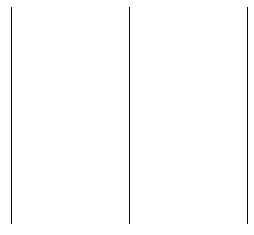

block5_conv2
512


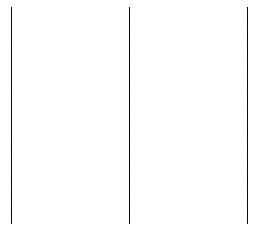

block5_conv3
512


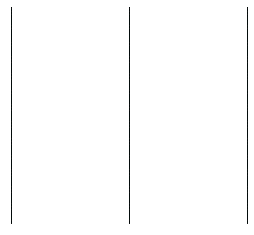

In [29]:
# Iterate through all the layers of the model

for layer in base_model.layers:
    if 'conv' in layer.name:
        weights, bias= layer.get_weights()
        # filters, biases = layer.get_weights()
        print(layer.name)
        # print(layer.name, filters.shape)
        # normalize filter values between  0 and 1 for visualization
        f_min, f_max = weights.min(), weights.max()
        filters = (weights - f_min) / (f_max - f_min)  
        print(filters.shape[3])
        filter_cnt=1
        # plotting all the filters
        for i in range(filters.shape[3]):
            # get the filters
            filt=filters[:,:,:, i]
            # plotting each of the channel, color image RGB channels
            for j in range(filters.shape[0]):
                ax = plt.subplot(filters.shape[3], filters.shape[0], filter_cnt)
                ax.set_xticks([])
                ax.set_yticks([])
                plt.imshow(filt[:,:, j])
                filter_cnt+=1
        plt.show()

1/1 [==============================] - 1s 897ms/step
(1, 180, 180, 64)
(1, 180, 180, 64)


<ipython-input-31-47a8ecf133b1>:42: RuntimeWarning: invalid value encountered in true_divide
  x /= x.std ()


(1, 90, 90, 64)
(1, 90, 90, 128)
(1, 90, 90, 128)
(1, 45, 45, 128)
(1, 45, 45, 256)
(1, 45, 45, 256)
(1, 45, 45, 256)
(1, 22, 22, 256)
(1, 22, 22, 512)
(1, 22, 22, 512)
(1, 22, 22, 512)
(1, 11, 11, 512)
(1, 11, 11, 512)
(1, 11, 11, 512)
(1, 11, 11, 512)
(1, 5, 5, 512)


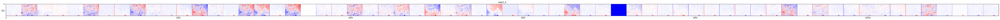

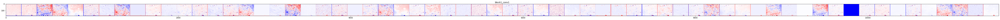

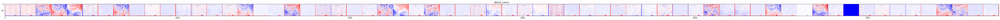

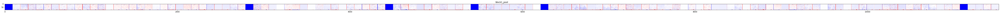

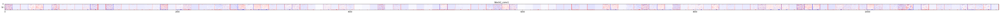

...

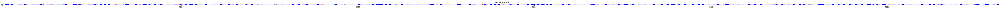

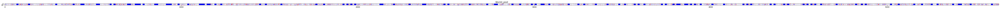

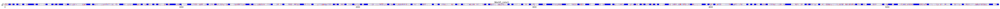

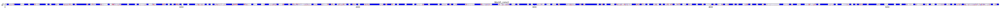

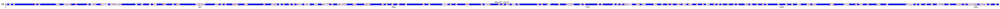

In [31]:
# Visualize feature maps for an organic image

# Image path
img_path=test_dir + '/C0_0' + '/ss_015.png'

# Define a new model, input=image 
# Output=intermediate representations for all layers in the previous model after the first
successive_outputs = [layer.output for layer in base_model.layers[1:]]

# Visualization_model = Model(img_input, successive_outputs)
visualization_model = tf.keras.models.Model(inputs = base_model.input, outputs = successive_outputs)

# Load the input image
img = load_img(img_path, target_size=(180, 180))

# Convert ht image to Array of dimension (180,180,3)
x = img_to_array(img)                           
x = x.reshape((1,) + x.shape)

# Rescale by 1/255
x /= 255.0
# Run input image through our visualization network to obtain all intermediate representations for the image
successive_feature_maps = visualization_model.predict(x)

# Retrieve the names of the layers, so we can have them as part of our plot
layer_names = [layer.name for layer in base_model.layers]
for layer_name, feature_map in zip(layer_names, successive_feature_maps):
  print(feature_map.shape)
  if len(feature_map.shape) == 4:
    
    # Plot Feature maps for the conv / maxpool layers, not the fully-connected layers
    n_features = feature_map.shape[-1]  # number of features in the feature map
    size = feature_map.shape[ 1]  # feature map shape (1, size, size, n_features)
    
    # Tile our images in a matrix
    display_grid = np.zeros((size, size * n_features))
    
    # Postprocess the feature to be visually palatable
    for i in range(n_features):
      x  = feature_map[0, :, :, i]
      x -= x.mean()
      x /= x.std ()
      x *=  64
      x += 128
      x  = np.clip(x, 0, 255).astype('uint8')
        
      # Tile each filter into a horizontal grid
      display_grid[:, i * size : (i + 1) * size] = x


      # Display the grid
    scale = 20. / n_features
    plt.figure(figsize=(scale * n_features*5, scale*4))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='bwr' )

# Disable tf warning
logging.getLogger('tensorflow').disabled = True
        

1/1 [==============================] - 0s 491ms/step
(1, 180, 180, 64)
(1, 180, 180, 64)
(1, 90, 90, 64)
(1, 90, 90, 128)
(1, 90, 90, 128)


<ipython-input-32-4284467f217d>:44: RuntimeWarning: invalid value encountered in true_divide
  x /= x.std ()


(1, 45, 45, 128)
(1, 45, 45, 256)
(1, 45, 45, 256)
(1, 45, 45, 256)
(1, 22, 22, 256)
(1, 22, 22, 512)
(1, 22, 22, 512)
(1, 22, 22, 512)
(1, 11, 11, 512)
(1, 11, 11, 512)
(1, 11, 11, 512)
(1, 11, 11, 512)
(1, 5, 5, 512)


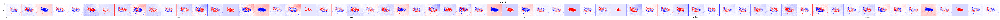

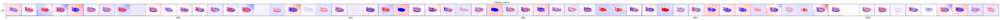

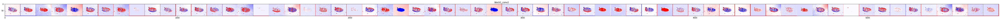

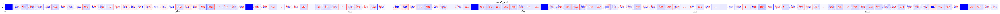

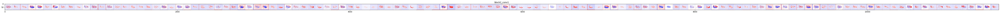

...

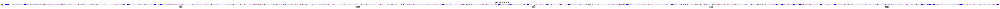

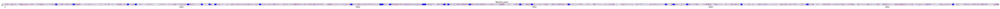

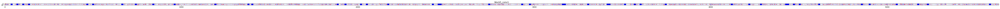

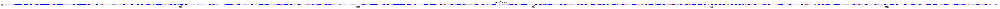

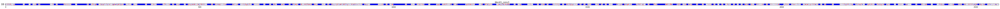

In [32]:
# Visualize feature maps for a recycled image

# Image path
img_path=test_dir + '/C1_0' + '/ss_0_005.png'

# Define a new model, input=image 
# Output=intermediate representations for all layers in the previous model after the first
successive_outputs = [layer.output for layer in base_model.layers[1:]]

# Visualization_model = Model(img_input, successive_outputs)
visualization_model = tf.keras.models.Model(inputs = base_model.input, outputs = successive_outputs)

# Load the input image
img = load_img(img_path, target_size=(180, 180))

# Convert ht image to Array of dimension (180,180,3)
x = img_to_array(img)                           
x = x.reshape((1,) + x.shape)

# Rescale by 1/255
x /= 255.0

# Run input image through our visualization network to obtain all intermediate representations for the image
successive_feature_maps = visualization_model.predict(x)

# Retrieve the names of the layers, so we can have them as part of our plot
layer_names = [layer.name for layer in base_model.layers]
for layer_name, feature_map in zip(layer_names, successive_feature_maps):
  print(feature_map.shape)
  if len(feature_map.shape) == 4:
    
    # Plot Feature maps for the conv / maxpool layers, not the fully-connected layers

    n_features = feature_map.shape[-1]  # number of features in the feature map
    size = feature_map.shape[ 1]  # feature map shape (1, size, size, n_features)

     # We will tile our images in this matrix
    display_grid = np.zeros((size, size * n_features))
    
    # Postprocess the feature to be visually palatable
    for i in range(n_features):
      x  = feature_map[0, :, :, i]
      x -= x.mean()
      x /= x.std ()
      x *=  64
      x += 128
      x  = np.clip(x, 0, 255).astype('uint8')
        
      # Tile each filter into a horizontal grid
      display_grid[:, i * size : (i + 1) * size] = x
        
# Display the grid
    scale = 20. / n_features
    plt.figure( figsize=(scale * n_features*5, scale*4) )
    plt.title ( layer_name )
    plt.grid  ( False )
    plt.imshow( display_grid, aspect='auto', cmap='bwr' )

# Ignore Runtimewarning
warnings.filterwarnings('ignore')

1/1 [==============================] - 0s 494ms/step
(1, 180, 180, 64)
(1, 180, 180, 64)
(1, 90, 90, 64)
(1, 90, 90, 128)
(1, 90, 90, 128)
(1, 45, 45, 128)
(1, 45, 45, 256)
(1, 45, 45, 256)
(1, 45, 45, 256)
(1, 22, 22, 256)
(1, 22, 22, 512)
(1, 22, 22, 512)
(1, 22, 22, 512)
(1, 11, 11, 512)
(1, 11, 11, 512)
(1, 11, 11, 512)
(1, 11, 11, 512)
(1, 5, 5, 512)


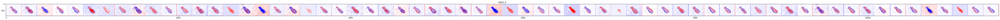

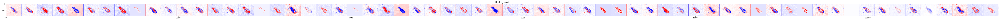

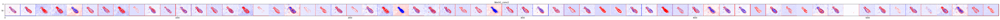

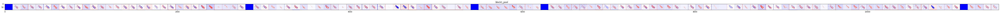

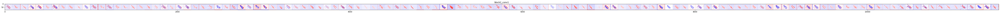

...

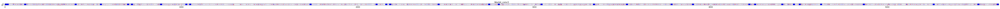

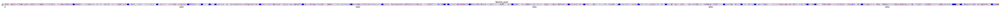

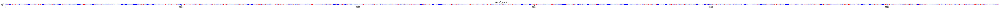

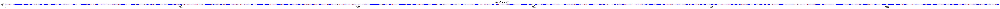

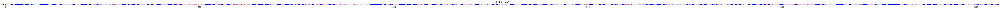

In [33]:
# Visualize feature maps for an organic image

# Image path
img_path=test_dir + '/C1_1' + '/ss_1_010.png'

# Define a new model, input=image 
# Output=intermediate representations for all layers in the previous model after the first
successive_outputs = [layer.output for layer in base_model.layers[1:]]

# Visualization_model = Model(img_input, successive_outputs)
visualization_model = tf.keras.models.Model(inputs = base_model.input, outputs = successive_outputs)

# Load the input image
img = load_img(img_path, target_size=(180, 180))

# Convert ht image to Array of dimension (180,180,3)
x = img_to_array(img)                           
x = x.reshape((1,) + x.shape)

# Rescale by 1/255
x /= 255.0
# Run input image through our visualization network to obtain all intermediate representations for the image
successive_feature_maps = visualization_model.predict(x)

# Retrieve the names of the layers, so we can have them as part of our plot
layer_names = [layer.name for layer in base_model.layers]
for layer_name, feature_map in zip(layer_names, successive_feature_maps):
  print(feature_map.shape)
  if len(feature_map.shape) == 4:
    
    # Plot Feature maps for the conv / maxpool layers, not the fully-connected layers
    n_features = feature_map.shape[-1]  # number of features in the feature map
    size = feature_map.shape[ 1]  # feature map shape (1, size, size, n_features)
    
    # Tile our images in a matrix
    display_grid = np.zeros((size, size * n_features))
    
    # Postprocess the feature to be visually palatable
    for i in range(n_features):
      x  = feature_map[0, :, :, i]
      x -= x.mean()
      x /= x.std ()
      x *=  64
      x += 128
      x  = np.clip(x, 0, 255).astype('uint8')
        
      # Tile each filter into a horizontal grid
      display_grid[:, i * size : (i + 1) * size] = x


      # Display the grid
    scale = 20. / n_features
    plt.figure(figsize=(scale * n_features*5, scale*4))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='bwr' )

# Disable tf warning
logging.getLogger('tensorflow').disabled = True
        

1/1 [==============================] - 1s 501ms/step
(1, 180, 180, 64)
(1, 180, 180, 64)
(1, 90, 90, 64)
(1, 90, 90, 128)
(1, 90, 90, 128)
(1, 45, 45, 128)
(1, 45, 45, 256)
(1, 45, 45, 256)
(1, 45, 45, 256)
(1, 22, 22, 256)
(1, 22, 22, 512)
(1, 22, 22, 512)
(1, 22, 22, 512)
(1, 11, 11, 512)
(1, 11, 11, 512)
(1, 11, 11, 512)
(1, 11, 11, 512)
(1, 5, 5, 512)


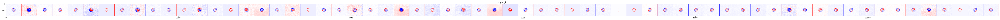

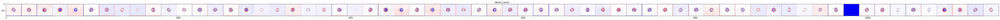

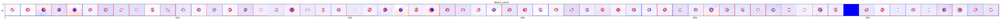

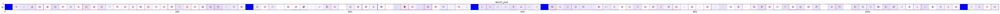

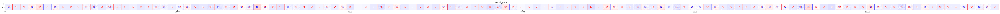

...

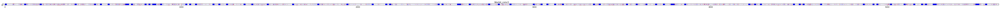

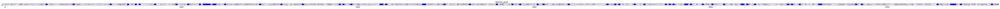

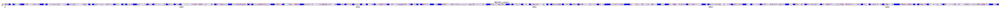

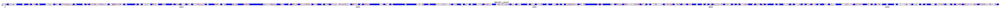

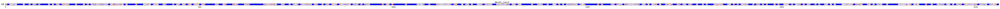

In [34]:
# Visualize feature maps for an organic image

# Image path
img_path=test_dir + '/C2_0' + '/ss_0_006.png'

# Define a new model, input=image 
# Output=intermediate representations for all layers in the previous model after the first
successive_outputs = [layer.output for layer in base_model.layers[1:]]

# Visualization_model = Model(img_input, successive_outputs)
visualization_model = tf.keras.models.Model(inputs = base_model.input, outputs = successive_outputs)

# Load the input image
img = load_img(img_path, target_size=(180, 180))

# Convert ht image to Array of dimension (180,180,3)
x = img_to_array(img)                           
x = x.reshape((1,) + x.shape)

# Rescale by 1/255
x /= 255.0
# Run input image through our visualization network to obtain all intermediate representations for the image
successive_feature_maps = visualization_model.predict(x)

# Retrieve the names of the layers, so we can have them as part of our plot
layer_names = [layer.name for layer in base_model.layers]
for layer_name, feature_map in zip(layer_names, successive_feature_maps):
  print(feature_map.shape)
  if len(feature_map.shape) == 4:
    
    # Plot Feature maps for the conv / maxpool layers, not the fully-connected layers
    n_features = feature_map.shape[-1]  # number of features in the feature map
    size = feature_map.shape[ 1]  # feature map shape (1, size, size, n_features)
    
    # Tile our images in a matrix
    display_grid = np.zeros((size, size * n_features))
    
    # Postprocess the feature to be visually palatable
    for i in range(n_features):
      x  = feature_map[0, :, :, i]
      x -= x.mean()
      x /= x.std ()
      x *=  64
      x += 128
      x  = np.clip(x, 0, 255).astype('uint8')
        
      # Tile each filter into a horizontal grid
      display_grid[:, i * size : (i + 1) * size] = x


      # Display the grid
    scale = 20. / n_features
    plt.figure(figsize=(scale * n_features*5, scale*4))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='bwr' )

# Disable tf warning
logging.getLogger('tensorflow').disabled = True
        

1/1 [==============================] - 1s 721ms/step
(1, 180, 180, 64)
(1, 180, 180, 64)
(1, 90, 90, 64)
(1, 90, 90, 128)
(1, 90, 90, 128)
(1, 45, 45, 128)
(1, 45, 45, 256)
(1, 45, 45, 256)
(1, 45, 45, 256)
(1, 22, 22, 256)
(1, 22, 22, 512)
(1, 22, 22, 512)
(1, 22, 22, 512)
(1, 11, 11, 512)
(1, 11, 11, 512)
(1, 11, 11, 512)
(1, 11, 11, 512)
(1, 5, 5, 512)


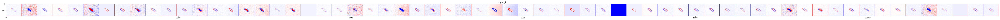

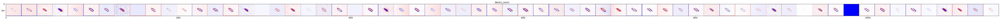

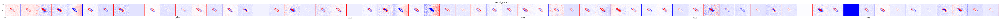

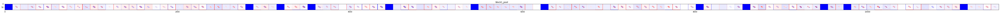

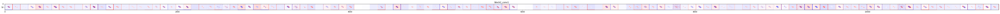

...

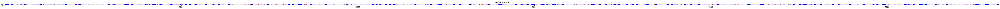

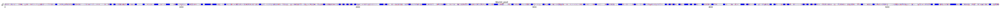

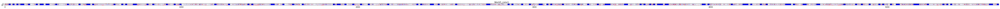

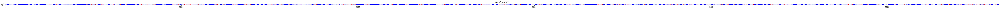

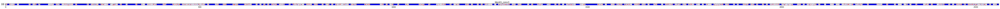

In [35]:
# Visualize feature maps for an organic image

# Image path
img_path=test_dir + '/C3_0' + '/ss_0_013.png'

# Define a new model, input=image 
# Output=intermediate representations for all layers in the previous model after the first
successive_outputs = [layer.output for layer in base_model.layers[1:]]

# Visualization_model = Model(img_input, successive_outputs)
visualization_model = tf.keras.models.Model(inputs = base_model.input, outputs = successive_outputs)

# Load the input image
img = load_img(img_path, target_size=(180, 180))

# Convert ht image to Array of dimension (180,180,3)
x = img_to_array(img)                           
x = x.reshape((1,) + x.shape)

# Rescale by 1/255
x /= 255.0
# Run input image through our visualization network to obtain all intermediate representations for the image
successive_feature_maps = visualization_model.predict(x)

# Retrieve the names of the layers, so we can have them as part of our plot
layer_names = [layer.name for layer in base_model.layers]
for layer_name, feature_map in zip(layer_names, successive_feature_maps):
  print(feature_map.shape)
  if len(feature_map.shape) == 4:
    
    # Plot Feature maps for the conv / maxpool layers, not the fully-connected layers
    n_features = feature_map.shape[-1]  # number of features in the feature map
    size = feature_map.shape[ 1]  # feature map shape (1, size, size, n_features)
    
    # Tile our images in a matrix
    display_grid = np.zeros((size, size * n_features))
    
    # Postprocess the feature to be visually palatable
    for i in range(n_features):
      x  = feature_map[0, :, :, i]
      x -= x.mean()
      x /= x.std ()
      x *=  64
      x += 128
      x  = np.clip(x, 0, 255).astype('uint8')
        
      # Tile each filter into a horizontal grid
      display_grid[:, i * size : (i + 1) * size] = x


      # Display the grid
    scale = 20. / n_features
    plt.figure(figsize=(scale * n_features*5, scale*4))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='bwr' )

# Disable tf warning
logging.getLogger('tensorflow').disabled = True
        

1/1 [==============================] - 1s 1s/step
(1, 180, 180, 64)
(1, 180, 180, 64)
(1, 90, 90, 64)
(1, 90, 90, 128)
(1, 90, 90, 128)
(1, 45, 45, 128)
(1, 45, 45, 256)
(1, 45, 45, 256)
(1, 45, 45, 256)
(1, 22, 22, 256)
(1, 22, 22, 512)
(1, 22, 22, 512)
(1, 22, 22, 512)
(1, 11, 11, 512)
(1, 11, 11, 512)
(1, 11, 11, 512)
(1, 11, 11, 512)
(1, 5, 5, 512)


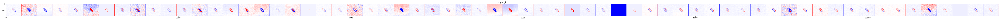

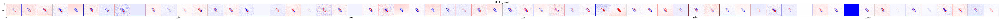

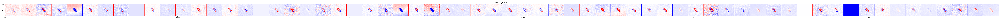

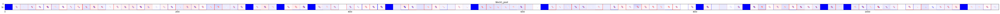

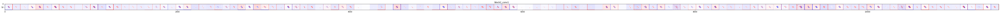

...

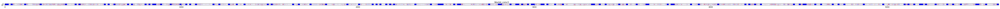

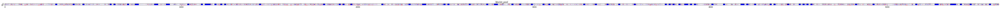

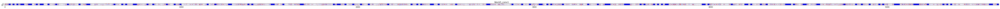

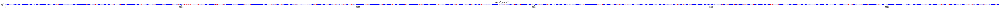

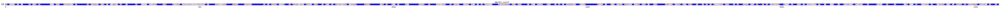

In [36]:
# Visualize feature maps for an organic image

# Image path
img_path=test_dir + '/C4_0' + '/ss_0_017.png'

# Define a new model, input=image 
# Output=intermediate representations for all layers in the previous model after the first
successive_outputs = [layer.output for layer in base_model.layers[1:]]

# Visualization_model = Model(img_input, successive_outputs)
visualization_model = tf.keras.models.Model(inputs = base_model.input, outputs = successive_outputs)

# Load the input image
img = load_img(img_path, target_size=(180, 180))

# Convert ht image to Array of dimension (180,180,3)
x = img_to_array(img)                           
x = x.reshape((1,) + x.shape)

# Rescale by 1/255
x /= 255.0
# Run input image through our visualization network to obtain all intermediate representations for the image
successive_feature_maps = visualization_model.predict(x)

# Retrieve the names of the layers, so we can have them as part of our plot
layer_names = [layer.name for layer in base_model.layers]
for layer_name, feature_map in zip(layer_names, successive_feature_maps):
  print(feature_map.shape)
  if len(feature_map.shape) == 4:
    
    # Plot Feature maps for the conv / maxpool layers, not the fully-connected layers
    n_features = feature_map.shape[-1]  # number of features in the feature map
    size = feature_map.shape[ 1]  # feature map shape (1, size, size, n_features)
    
    # Tile our images in a matrix
    display_grid = np.zeros((size, size * n_features))
    
    # Postprocess the feature to be visually palatable
    for i in range(n_features):
      x  = feature_map[0, :, :, i]
      x -= x.mean()
      x /= x.std ()
      x *=  64
      x += 128
      x  = np.clip(x, 0, 255).astype('uint8')
        
      # Tile each filter into a horizontal grid
      display_grid[:, i * size : (i + 1) * size] = x


      # Display the grid
    scale = 20. / n_features
    plt.figure(figsize=(scale * n_features*5, scale*4))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='bwr' )

# Disable tf warning
logging.getLogger('tensorflow').disabled = True
        

1/1 [==============================] - 1s 501ms/step
(1, 180, 180, 64)
(1, 180, 180, 64)
(1, 90, 90, 64)
(1, 90, 90, 128)
(1, 90, 90, 128)
(1, 45, 45, 128)
(1, 45, 45, 256)
(1, 45, 45, 256)
(1, 45, 45, 256)
(1, 22, 22, 256)
(1, 22, 22, 512)
(1, 22, 22, 512)
(1, 22, 22, 512)
(1, 11, 11, 512)
(1, 11, 11, 512)
(1, 11, 11, 512)
(1, 11, 11, 512)
(1, 5, 5, 512)


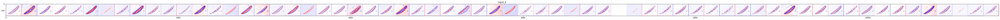

In [ ]:
# Visualize feature maps for an organic image

# Image path
img_path=test_dir + '/C5_0' + '/ss_0_027.png'

# Define a new model, input=image 
# Output=intermediate representations for all layers in the previous model after the first
successive_outputs = [layer.output for layer in base_model.layers[1:]]

# Visualization_model = Model(img_input, successive_outputs)
visualization_model = tf.keras.models.Model(inputs = base_model.input, outputs = successive_outputs)

# Load the input image
img = load_img(img_path, target_size=(180, 180))

# Convert ht image to Array of dimension (180,180,3)
x = img_to_array(img)                           
x = x.reshape((1,) + x.shape)

# Rescale by 1/255
x /= 255.0
# Run input image through our visualization network to obtain all intermediate representations for the image
successive_feature_maps = visualization_model.predict(x)

# Retrieve the names of the layers, so we can have them as part of our plot
layer_names = [layer.name for layer in base_model.layers]
for layer_name, feature_map in zip(layer_names, successive_feature_maps):
  print(feature_map.shape)
  if len(feature_map.shape) == 4:
    
    # Plot Feature maps for the conv / maxpool layers, not the fully-connected layers
    n_features = feature_map.shape[-1]  # number of features in the feature map
    size = feature_map.shape[ 1]  # feature map shape (1, size, size, n_features)
    
    # Tile our images in a matrix
    display_grid = np.zeros((size, size * n_features))
    
    # Postprocess the feature to be visually palatable
    for i in range(n_features):
      x  = feature_map[0, :, :, i]
      x -= x.mean()
      x /= x.std ()
      x *=  64
      x += 128
      x  = np.clip(x, 0, 255).astype('uint8')
        
      # Tile each filter into a horizontal grid
      display_grid[:, i * size : (i + 1) * size] = x


      # Display the grid
    scale = 20. / n_features
    plt.figure(figsize=(scale * n_features*5, scale*4))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='bwr' )

# Disable tf warning
logging.getLogger('tensorflow').disabled = True
        

1/1 [==============================] - 1s 569ms/step
(1, 180, 180, 64)
(1, 180, 180, 64)
(1, 90, 90, 64)
(1, 90, 90, 128)
(1, 90, 90, 128)
(1, 45, 45, 128)
(1, 45, 45, 256)
(1, 45, 45, 256)
(1, 45, 45, 256)
(1, 22, 22, 256)
(1, 22, 22, 512)
(1, 22, 22, 512)
(1, 22, 22, 512)
(1, 11, 11, 512)
(1, 11, 11, 512)
(1, 11, 11, 512)
(1, 11, 11, 512)
(1, 5, 5, 512)


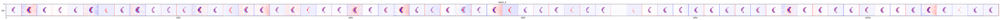

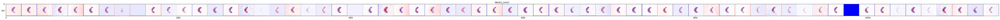

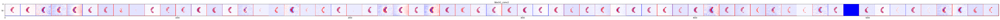

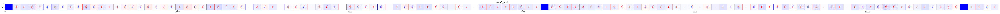

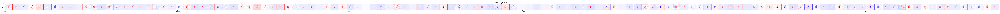

...

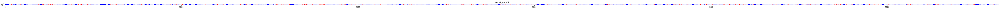

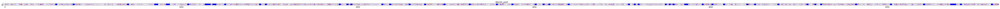

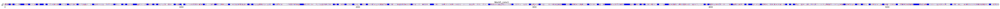

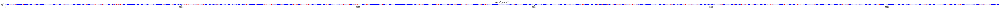

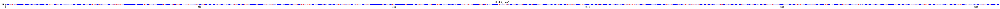

In [38]:
# Visualize feature maps for an organic image

# Image path
img_path=test_dir + '/C6_0' + '/ss_0_016.png'

# Define a new model, input=image 
# Output=intermediate representations for all layers in the previous model after the first
successive_outputs = [layer.output for layer in base_model.layers[1:]]

# Visualization_model = Model(img_input, successive_outputs)
visualization_model = tf.keras.models.Model(inputs = base_model.input, outputs = successive_outputs)

# Load the input image
img = load_img(img_path, target_size=(180, 180))

# Convert ht image to Array of dimension (180,180,3)
x = img_to_array(img)                           
x = x.reshape((1,) + x.shape)

# Rescale by 1/255
x /= 255.0
# Run input image through our visualization network to obtain all intermediate representations for the image
successive_feature_maps = visualization_model.predict(x)

# Retrieve the names of the layers, so we can have them as part of our plot
layer_names = [layer.name for layer in base_model.layers]
for layer_name, feature_map in zip(layer_names, successive_feature_maps):
  print(feature_map.shape)
  if len(feature_map.shape) == 4:
    
    # Plot Feature maps for the conv / maxpool layers, not the fully-connected layers
    n_features = feature_map.shape[-1]  # number of features in the feature map
    size = feature_map.shape[ 1]  # feature map shape (1, size, size, n_features)
    
    # Tile our images in a matrix
    display_grid = np.zeros((size, size * n_features))
    
    # Postprocess the feature to be visually palatable
    for i in range(n_features):
      x  = feature_map[0, :, :, i]
      x -= x.mean()
      x /= x.std ()
      x *=  64
      x += 128
      x  = np.clip(x, 0, 255).astype('uint8')
        
      # Tile each filter into a horizontal grid
      display_grid[:, i * size : (i + 1) * size] = x


      # Display the grid
    scale = 20. / n_features
    plt.figure(figsize=(scale * n_features*5, scale*4))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='bwr' )

# Disable tf warning
logging.getLogger('tensorflow').disabled = True
        

1/1 [==============================] - 2s 2s/step
(1, 180, 180, 64)
(1, 180, 180, 64)
(1, 90, 90, 64)
(1, 90, 90, 128)
(1, 90, 90, 128)
(1, 45, 45, 128)
(1, 45, 45, 256)
(1, 45, 45, 256)
(1, 45, 45, 256)
(1, 22, 22, 256)
(1, 22, 22, 512)
(1, 22, 22, 512)
(1, 22, 22, 512)
(1, 11, 11, 512)
(1, 11, 11, 512)
(1, 11, 11, 512)
(1, 11, 11, 512)
(1, 5, 5, 512)


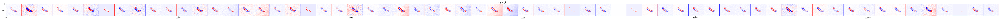

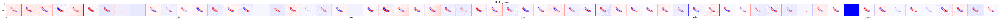

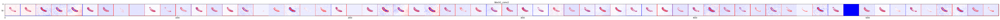

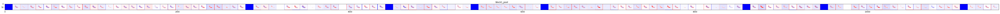

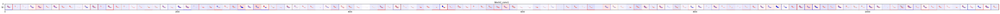

...

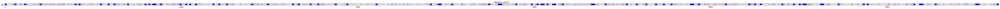

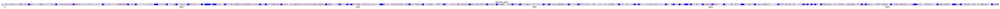

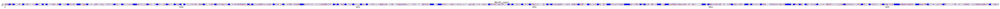

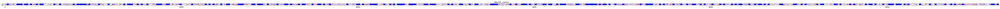

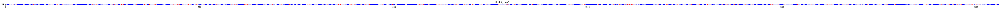

In [39]:
# Visualize feature maps for an organic image

# Image path
img_path=test_dir + '/C6_1' + '/ss_1_020.png'

# Define a new model, input=image 
# Output=intermediate representations for all layers in the previous model after the first
successive_outputs = [layer.output for layer in base_model.layers[1:]]

# Visualization_model = Model(img_input, successive_outputs)
visualization_model = tf.keras.models.Model(inputs = base_model.input, outputs = successive_outputs)

# Load the input image
img = load_img(img_path, target_size=(180, 180))

# Convert ht image to Array of dimension (180,180,3)
x = img_to_array(img)                           
x = x.reshape((1,) + x.shape)

# Rescale by 1/255
x /= 255.0
# Run input image through our visualization network to obtain all intermediate representations for the image
successive_feature_maps = visualization_model.predict(x)

# Retrieve the names of the layers, so we can have them as part of our plot
layer_names = [layer.name for layer in base_model.layers]
for layer_name, feature_map in zip(layer_names, successive_feature_maps):
  print(feature_map.shape)
  if len(feature_map.shape) == 4:
    
    # Plot Feature maps for the conv / maxpool layers, not the fully-connected layers
    n_features = feature_map.shape[-1]  # number of features in the feature map
    size = feature_map.shape[ 1]  # feature map shape (1, size, size, n_features)
    
    # Tile our images in a matrix
    display_grid = np.zeros((size, size * n_features))
    
    # Postprocess the feature to be visually palatable
    for i in range(n_features):
      x  = feature_map[0, :, :, i]
      x -= x.mean()
      x /= x.std ()
      x *=  64
      x += 128
      x  = np.clip(x, 0, 255).astype('uint8')
        
      # Tile each filter into a horizontal grid
      display_grid[:, i * size : (i + 1) * size] = x


      # Display the grid
    scale = 20. / n_features
    plt.figure(figsize=(scale * n_features*5, scale*4))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='bwr' )

# Disable tf warning
logging.getLogger('tensorflow').disabled = True
        

In [40]:
# Defining Layers
model=Sequential()
model.add(base_model) 
model.add(Dropout(0.2))
model.add(Flatten())

# Add dense layers
model.add(BatchNormalization())
model.add(Dense(5000,activation="relu",kernel_initializer='he_uniform'))
model.add(BatchNormalization())
model.add(Dropout(0.2))
model.add(Dense(1000,activation="relu",kernel_initializer='he_uniform'))
model.add(BatchNormalization())
model.add(Dropout(0.2))
model.add(Dense(500,activation="relu",kernel_initializer='he_uniform'))
model.add(Dropout(0.2))
model.add(Dense(9,activation="softmax"))

In [41]:
# Show model summary (with custom layers)

model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 5, 5, 512)         14714688  
                                                                 
 dropout (Dropout)           (None, 5, 5, 512)         0         
                                                                 
 flatten (Flatten)           (None, 12800)             0         
                                                                 
 batch_normalization (BatchN  (None, 12800)            51200     
 ormalization)                                                   
                                                                 
 dense (Dense)               (None, 5000)              64005000  
                                                                 
 batch_normalization_1 (Batc  (None, 5000)             20000     
 hNormalization)                                        

In [43]:

# Model fit (training)

model.compile(loss="categorical_crossentropy", optimizer="adam", metrics=[tf.keras.metrics.AUC(name = 'auc')])
model_history = model.fit(train_ds, epochs=2, validation_data=valid_ds, callbacks = callback_list, verbose = 1)

Epoch 1/2
5/5 [==============================] - ETA: 0s - loss: 2.4878 - auc: 0.7420 
Epoch 1: val_auc improved from -inf to 0.52910, saving model to ./final_model_weights.hdf5
5/5 [==============================] - 222s 44s/step - loss: 2.4878 - auc: 0.7420 - val_loss: 426.4984 - val_auc: 0.5291
Epoch 2/2
5/5 [==============================] - ETA: 0s - loss: 2.3412 - auc: 0.7811 
Epoch 2: val_auc improved from 0.52910 to 0.53977, saving model to ./final_model_weights.hdf5
5/5 [==============================] - 211s 44s/step - loss: 2.3412 - auc: 0.7811 - val_loss: 50397.3477 - val_auc: 0.5398


In [44]:
# Storing loss and accuracy values into a DataFrame to save permanently for plots

# Store model.fit results in a variable
history = model_history

# Save as DataFrame:     
history_df = pd.DataFrame(history.history) 
history_df

,loss,auc,val_loss,val_auc
0,2.487787,0.741960,426.498413,0.529098
1,2.341152,0.781117,50397.347656,0.539773


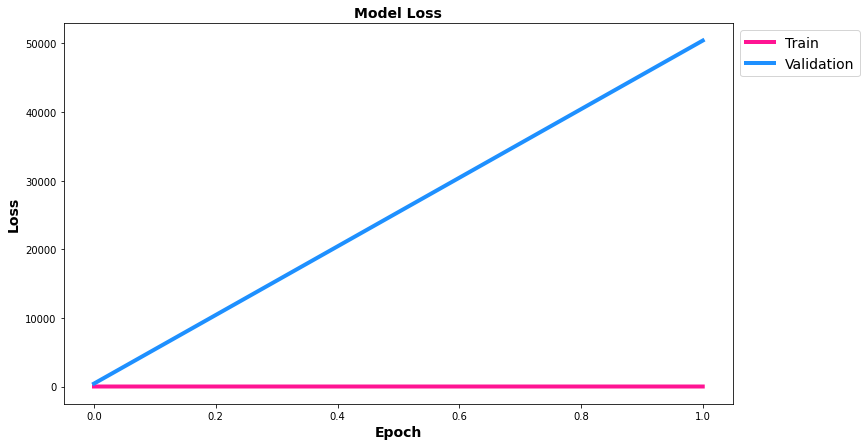

In [46]:
# Plot model loss

plt.figure(figsize=(12,7))
plt.plot(history_df['loss'], color='deeppink', linewidth=4)
plt.plot(history_df['val_loss'], color='dodgerblue', linewidth=4)
plt.title('Model Loss', fontsize=14, fontweight='bold')
plt.ylabel('Loss', fontsize=14, fontweight='bold')
plt.xlabel('Epoch', fontsize=14, fontweight='bold')
plt.legend(['Train', 'Validation'], loc='upper left', bbox_to_anchor=(1,1), fontsize=14)
plt.show()

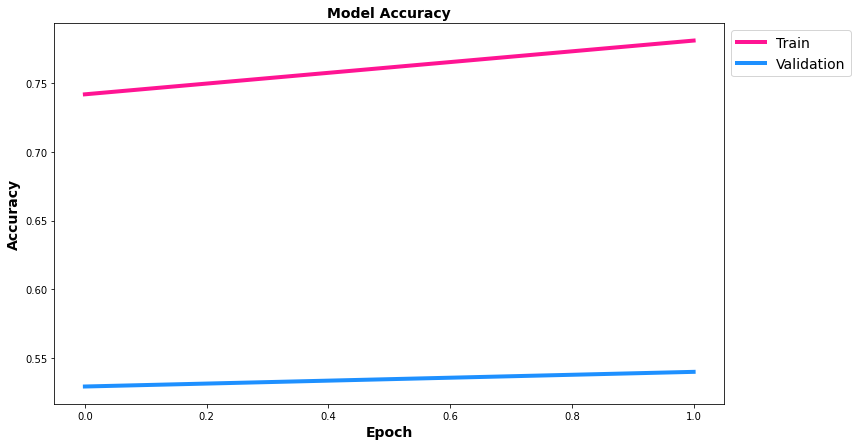

In [47]:
# Plot the model accuracy

plt.figure(figsize=(12,7))
plt.plot(history_df['auc'], color='deeppink', linewidth=4)
plt.plot(history_df['val_auc'], color='dodgerblue', linewidth=4)
plt.title('Model Accuracy', fontsize=14, fontweight='bold')
plt.ylabel('Accuracy', fontsize=14, fontweight='bold')
plt.xlabel('Epoch', fontsize=14, fontweight='bold')
plt.legend(['Train', 'Validation'], loc='upper left', bbox_to_anchor=(1,1), fontsize=14)
plt.show()

In [48]:
# Evaluate overall loss and accuracy for test data
model.evaluate(test_ds)

2/2 [==============================] - 14s 3s/step - loss: 54847.5000 - auc: 0.5335


[54847.5, 0.5335365533828735]

In [49]:
# Confusion Matrix and Classification Report

metrics=tf.keras.metrics.AUC(name = 'auc')

num_of_test_samples = 41
batch_size = 32

Y_pred = model.predict(test_ds, num_of_test_samples // batch_size+1)
y_pred = np.argmax(Y_pred, axis=1)
print('Confusion Matrix')
print(confusion_matrix(test_ds.classes, y_pred))
print('Classification Report')
target_names = ['C0_0','C1_0','C1_1','C2_0','C3_0','C4_0','C5_0','C6_0','C6_1']
print(classification_report(test_ds.classes, y_pred, target_names=target_names))

2/2 [==============================] - 15s 3s/step
Confusion Matrix
[[0 0 0 0 0 0 5 0 0]
 [0 0 0 0 0 0 2 0 0]
 [0 0 0 0 0 0 3 0 0]
 [0 0 0 0 0 0 2 0 0]
 [0 0 0 0 0 0 4 0 0]
 [0 0 0 0 0 0 6 0 0]
 [0 0 0 0 0 0 7 0 0]
 [0 0 0 0 0 0 5 0 0]
 [0 0 0 0 0 0 7 0 0]]
Classification Report
              precision    recall  f1-score   support

        C0_0       0.00      0.00      0.00         5
        C1_0       0.00      0.00      0.00         2
        C1_1       0.00      0.00      0.00         3
        C2_0       0.00      0.00      0.00         2
        C3_0       0.00      0.00      0.00         4
        C4_0       0.00      0.00      0.00         6
        C5_0       0.17      1.00      0.29         7
        C6_0       0.00      0.00      0.00         5
        C6_1       0.00      0.00      0.00         7

    accuracy                           0.17        41
   macro avg       0.02      0.11      0.03        41
weighted avg       0.03      0.17      0.05        41



Text(0.5, 1.0, 'Classification Report')

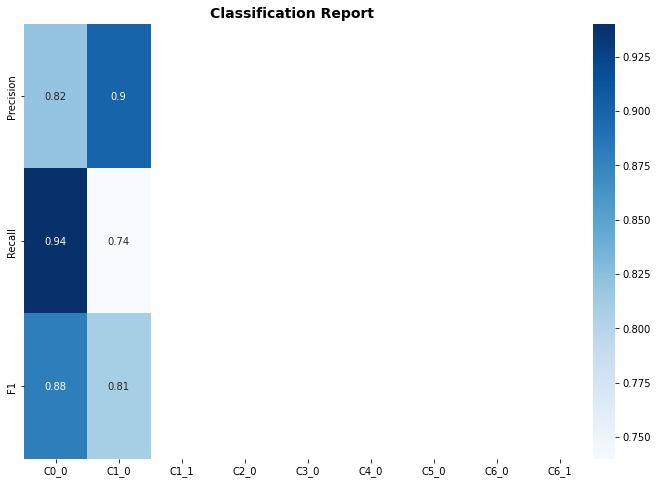

In [50]:
# Plot the classification report

# Put data into a 2D array
data = np.array([[.82, .90],
                 [.94, .74],
                [.88, .81]])

# Plot the heatmap
yticklabels = ['Precision', 'Recall', 'F1']
xticklabels = ['C0_0','C1_0','C1_1','C2_0','C3_0','C4_0','C5_0','C6_0','C6_1']
fig, ax = plt.subplots(figsize=(12,8)) 
ax = sns.heatmap(data, xticklabels=xticklabels, yticklabels=yticklabels, annot=True, cmap='Blues')
ax.set_title("Classification Report", fontsize=14, fontweight='bold')

In [51]:
# Load the saved model weights

model = load_model('/content/final_model_weights.hdf5')

In [52]:
def getprediction(img):
    img = img_to_array(img)
    img = img / 255
    imshow(img)
    plt.axis('off')
    img = np.expand_dims(img,axis=0)
    category = model.predict_classes(img)
    answer = category[0]
    probability = model.predict_proba(img)
    # probability_results = probability[0][0]
    if answer == 0:
        print(f"The image belongs to C0_0 category, probability: {probability[0][1]}.")
    elif answer == 1:
        print(f"The image belongs to C1_0 category, probability: {probability[0][0]}.")
    elif answer == 2:
        print(f"The image belongs to C1_1 category, probability: {probability[0][0]}.")
    elif answer == 3:
        print(f"The image belongs to C2_0 category, probability: {probability[0][0]}.")
    elif answer == 4:
        print(f"The image belongs to C3_0 category, probability: {probability[0][0]}.")
    elif answer == 5:
        print(f"The image belongs to C4_0 category, probability: {probability[0][0]}.")
    elif answer == 6:
        print(f"The image belongs to C5_0 category, probability: {probability[0][0]}.")
    elif answer == 7:
        print(f"The image belongs to C6_0 category, probability: {probability[0][0]}.")
    else:
      print(f"The image belongs to C6_1 category, probability: {probability[0][0]}.")
      


     